In [1]:
using HTTP, JSON, JuliaDB, JuliaDBMeta, LinearAlgebra, Markdown, Random, Roots, StatsBase, VegaLite

### 1.3 Crash Course by Example

In [2]:
function bubblesort!(a)
    for i=1:length(a)-1
        for j=(i+1):length(a)
            if a[i] > a[j]
                a[i], a[j] = a[j], a[i]
            end
        end
    end
    a
end

bubblesort!([65, 51, 32, 12, 23, 84, 68, 1])'

1×8 Adjoint{Int64,Array{Int64,1}}:
 1  12  23  32  51  65  68  84

In [3]:
function polynomialf(a...)
    a0 = a[1]
    a = a[2:end]
    x -> a0 + sum(a[n]*x^n for n=1:length(a))
end

println(@time find_zeros(polynomialf(1, 3, -10), -10, 10))

  2.078533 seconds (7.46 M allocations: 375.761 MiB, 5.78% gc time)
[-0.2, 0.5]


In [4]:
P = [ 0.5 0.4 0.1; 
      0.3 0.2 0.5; 
      0.5 0.3 0.2 ]

display.((
    md"### First way",
    mean(P^100, dims=1)[1, :],

    md"### Second way",
    vcat((P' - I)[1:2, :], [1 1 1])\[0; 0; 1],

    md"### Third way",
    findmax(abs.(eigvals(P)))[2] |>
    maxveci -> eigvecs(copy(P'))[:, maxveci] |>
    maxvec -> real.(normalize(maxvec, 1)),

    md"### Fourth way",
    reduce(1:1_000_000, init=(1, [0 0 0], weights.(eachrow(P)))) do (state, states, weights), t_
        newstate = sample(1:3, weights[state])
        states[newstate] += 1
        newstate, states, weights
    end |> 
    vec -> (vec[2] / 1_000_000)[1,:]
));

### First way


3-element Array{Float64,1}:
 0.43750000000000056
 0.31250000000000044
 0.25000000000000033

### Second way


3-element Array{Float64,1}:
 0.43750000000000006
 0.31249999999999994
 0.25               

### Third way


3-element Array{Float64,1}:
 0.43749999999999994
 0.31250000000000006
 0.24999999999999997

### Fourth way


3-element Array{Float64,1}:
 0.438025
 0.3117  
 0.250275

In [5]:
shakespeare = HTTP.get("https://ocw.mit.edu/ans7870/6/6.006/s08/lecturenotes/files/t8.shakespeare.txt").body |> split∘String
jsonCode = HTTP.get("https://raw.githubusercontent.com/h-Klok/StatsWithJuliaBook/master/1_chapter/jsonCode.json").body |> JSON.parse∘String

display(jsonCode)

filter(in(Set(jsonCode["words"])), map(strip∘lowercase, shakespeare)) |>
countmap |> 
freq -> sort(collect(freq), by=last, rev=true)[1:jsonCode["numToShow"]]

Dict{String,Any} with 2 entries:
  "numToShow" => 5
  "words"     => Any["heaven", "hell", "man", "woman", "boy", "girl", "king", "…

5-element Array{Pair{SubString{String},Int64},1}:
 "king" => 1698
 "love" => 1279
  "man" => 1033
  "sir" => 721 
  "god" => 555 

### 1.4 Plots, Images and Graphics

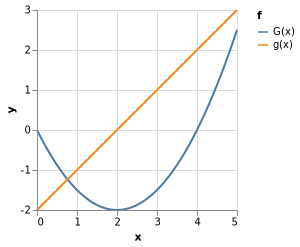

In [6]:
x = 0:.1:5
G(x) = .5x^2 -2x
g(x) = x - 2
merge(
    table(x, G.(x), fill("G(x)", length(x)), names = (:x, :y, :f)),
    table(x, g.(x), fill("g(x)", length(x)), names = (:x, :y, :f))
) |>
@vlplot(mark=:line, x=:x, y=:y, color=:f, background="white")

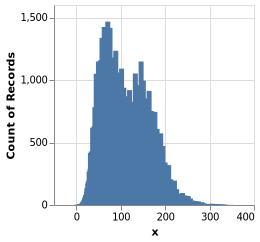

In [7]:
function hailstone(x::Int)
    n = 0
    while x != 1
        x = x % 2 == 0 ? Int(x / 2) : 3x + 1
        n += 1
    end
    n
end

table(hailstone.(2:10^5), names=(:x,)) |>
@vlplot(:bar, x=:x, y="count()", background="white")

### 1.5 Random Numbers and Monte Carlo

In [8]:
for seed=[0:3; 0:1]
    Random.seed!(seed)
    println(seed, " ", rand(5))
end

0 [0.823648, 0.910357, 0.164566, 0.177329, 0.27888]
1 [0.236033, 0.346517, 0.312707, 0.00790928, 0.488613]
2 [0.366796, 0.523879, 0.210256, 0.819338, 0.501371]
3 [0.811698, 0.988432, 0.807622, 0.970091, 0.140061]
0 [0.823648, 0.910357, 0.164566, 0.177329, 0.27888]
1 [0.236033, 0.346517, 0.312707, 0.00790928, 0.488613]


### π estimated: 3.1068


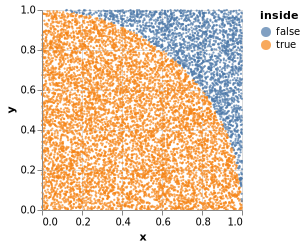

In [9]:
df = @transform table(rand(10^4), rand(10^4), names=(:x, :y)) {
    inside = norm([:x :y]) <= 1
}

π_est = @with df 4sum(:inside) / length(_)
display(md"### π estimated: $π_est")

df |> @vlplot(
    mark={:point, filled=true, size=5},
    x=:x,
    y=:y,
    color="inside:n",
    background="white"
)

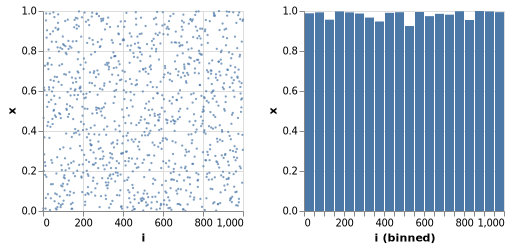

In [10]:
next(x) = (69069x + 1) % 2^32

N = 10^6
data = reduce(2:N, init=fill(808, N)) do data, i
    data[i] = next(data[i-1])
    data
end / 2^32

enumerate(data[1:1000]) |>
df -> table(first.(df), last.(df), names=(:i, :x)) |>
df -> hcat(
    df |> @vlplot(
        mark={:point, filled=true, size=5},
        x=:i,
        y=:x,
        background="white"
    ),
    df |> @vlplot(
        mark=:bar,
        x={:i, bin={maxbins=20}},
        y=:x,
        background="white"
    )
)

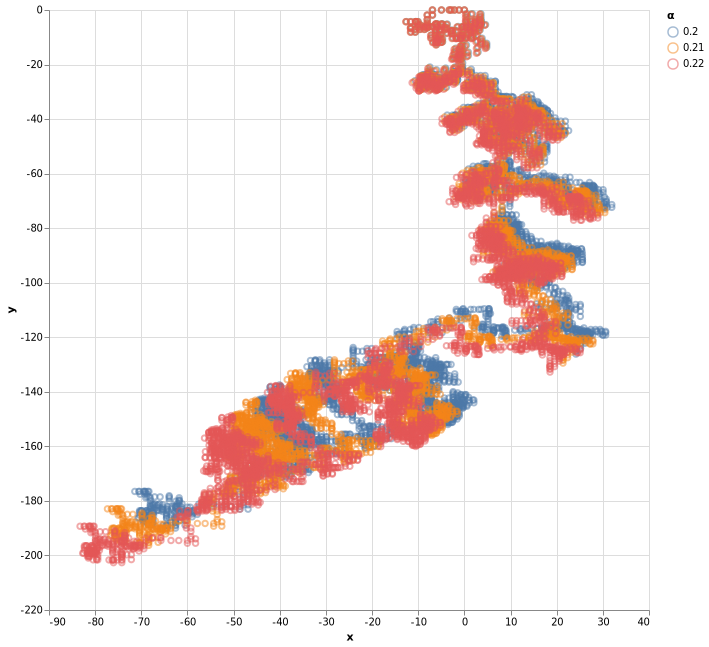

In [11]:
path(rng, α) = reduce(2:5_000, init=zeros(5_000, 2)) do path, t
    dir = rand(rng, 1:4)
    path[t,:] = path[t-1,:] + (
        if dir==1
            [1, 0]
        elseif dir==2
            [0, 1]
        elseif dir==3
            [-(2+α) * rand(rng), 0]
        elseif dir==4
            [0, -(2+α) * rand(rng)]
        end
    )
    path
end

vcat([hcat(path(MersenneTwister(27), α), fill(α, 5_000)) for α=.2:.01:.22]...) |>
a -> table(eachcol(a)..., names=(:x, :y, :α)) |>
@vlplot(mark={:point, opacity=.5}, x=:x, y=:y, color="α:n", background="white", width=600, height=600)

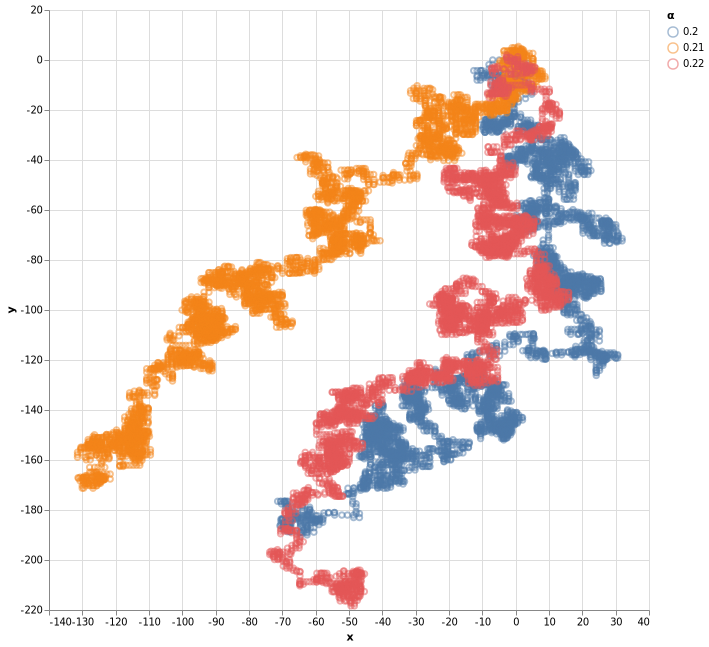

In [12]:
rng = MersenneTwister(27)
vcat([hcat(path(rng, α), fill(α, 5_000)) for α=.2:.01:.22]...) |>
a -> table(eachcol(a)..., names=(:x, :y, :α)) |>
@vlplot(mark={:point, opacity=.5}, x=:x, y=:y, color="α:n", background="white", width=600, height=600)

### 1.6 Integration with Other Languages